In [286]:
%reload_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
import scipy as sp
import glob
import os
from omegaconf import OmegaConf

import matplotlib.pyplot as plt
from matplotlib import cm
plt.style.use('bmh')
import seaborn as sns
%matplotlib inline
plt.rcParams['figure.dpi'] = 400
plt.rcParams['font.size'] = 8
plt.rcParams['legend.fontsize'] = 7
plt.rcParams['legend.loc'] = 'lower right'

In [2]:
def load_run(run_dir, ty):
    df = pd.read_csv(os.path.join(run_dir, f'{ty}.csv'))
    run_id = run_dir.split('/')[-1]
    df['run_id'] = f'run={run_id}'
    overrides = OmegaConf.load(os.path.join(run_dir, '.hydra', 'overrides.yaml'))
    for override in overrides:
        key = override.split('=')[0]
        value = '='.join(override.split('=')[1:])
        df[key] = value
    return df

def load_experiment(exp_dirs, ty='eval'):
    run_dirs = []
    for exp_dir in exp_dirs:
        run_dirs += glob.glob(os.path.join(exp_dir, '*'))
    
    dfs = []
    for run_dir in run_dirs:
        try:
            df = load_run(run_dir, ty)
            dfs.append(df)
        except:
            pass
        
    return pd.concat(dfs, sort=False)

In [279]:
def plot(df,  key='episode_reward', nrow=1):
    envs = np.sort(df['env'].unique())
    ncol = (envs.shape[0] + nrow - 1) // nrow
    nrow = nrow
    fig, axs = plt.subplots(nrow, ncol, figsize=(4 * ncol, 3 * nrow))

    #runs = sorted([str(x) for x in df.run.unique()])
    
    x = 'timesteps ($\\times 1000$)'
    df[x] = df['step'] * 0.001

    for idx, env in enumerate(envs):
        data = df[df['env'] == env]
        row = idx // ncol
        col = idx % ncol
        if nrow > 1 and ncol > 1:
            ax = axs[row, col]
        elif nrow > 1 or ncol > 1:
            ax = axs[idx]
        else:
            ax = axs
        hue_order = np.sort(data.Agent.unique())
        #import ipdb; ipdb.set_trace()
        sns.lineplot(x=x, y=key, data=data, ci='sd', hue='Agent', hue_order=hue_order, ax=ax)
        #sns.lineplot(x='step', y=key, data=data, ci='sd', hue='run_id', ax=ax, palette=sns.color_palette('Blues')[3:4])
        
        ax.set_title(f'{env}')
        #ax.set_xlim(0, 10000000)
        #ax.set_ylim(0.0, 1050.0)
        #ax.legend_.remove()
        
    plt.tight_layout()
    plt.show()

In [195]:
def plot_runs(df,  key='episode_reward', nrow=1):
    envs = np.sort(df['env'].unique())
    ncol = (envs.shape[0] + nrow - 1) // nrow
    nrow = nrow
    fig, axs = plt.subplots(nrow, ncol, figsize=(4 * ncol, 3 * nrow))

    #runs = sorted([str(x) for x in df.run.unique()])
    
    x = 'timesteps ($\\times 1000$)'
    df[x] = df['step'] * 0.001

    for idx, env in enumerate(envs):
        data = df[df['env'] == env]
        row = idx // ncol
        col = idx % ncol
        if nrow > 1 and ncol > 1:
            ax = axs[row, col]
        elif nrow > 1 or ncol > 1:
            ax = axs[idx]
        else:
            ax = axs
        hue_order = np.sort(data.Agent.unique())
        #import ipdb; ipdb.set_trace()
        #sns.lineplot(x=x, y=key, data=data, ci='sd', hue='run_id', hue_order=hue_order, ax=ax)
        sns.lineplot(x=x, y=key, data=data, ci='sd', hue='run_id', ax=ax)
        
        ax.set_title(f'{env}')
        #ax.set_xlim(0, 10000000)
        #ax.set_ylim(0.0, 1050.0)
        #ax.legend_.remove()
        
    plt.tight_layout()
    plt.show()

In [135]:
df[(df['action_type'] == 'position') & (df['env'] == 'task_3:action=position,init_p=0.5') & (df['Agent'] == 'teacher:std=0.4') & (df['seed'] == str(2))][['seed', 'episode_reward', 'run_id']]

,seed,episode_reward,run_id
0,2,0.275958,run=76
1,2,0.207109,run=76
2,2,0.166803,run=76
3,2,0.192837,run=76
4,2,0.283401,run=76
...,...,...,...
195,2,0.783271,run=76
196,2,0.761553,run=76
197,2,0.723213,run=76
198,2,0.772682,run=76


In [147]:
df[(df['action_type'] == 'position') & (df['env'] == 'task_2:action=position,std=0.4') & (df['Agent'] == 'mixer:a0=1.0,a1=10.0') & (df['seed'] == str(2))][['seed', 'episode_reward', 'run_id']]

,seed,episode_reward,run_id
0,2,0.045134,run=43
1,2,0.124039,run=43
2,2,0.064538,run=43
3,2,0.077040,run=43
4,2,0.051010,run=43
...,...,...,...
67,2,0.190816,run=43
68,2,0.197577,run=43
69,2,0.141500,run=43
70,2,0.206596,run=43


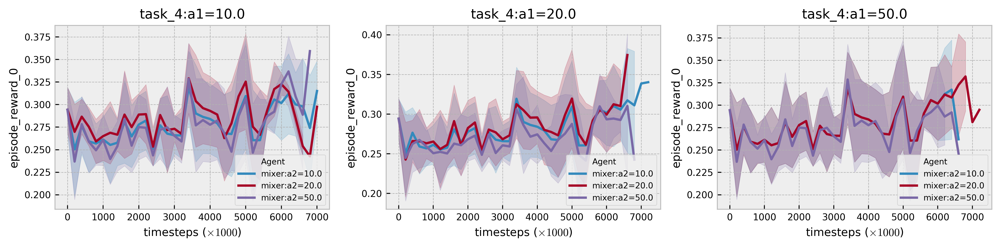

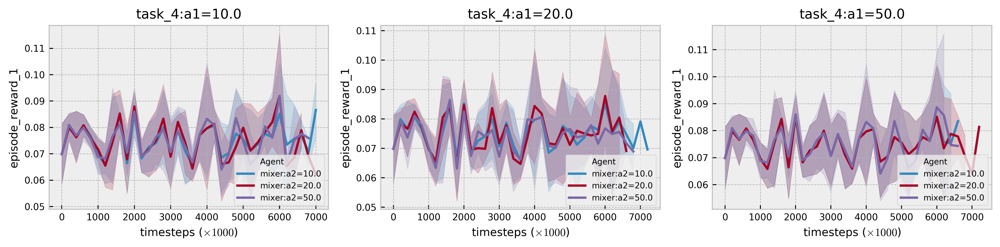

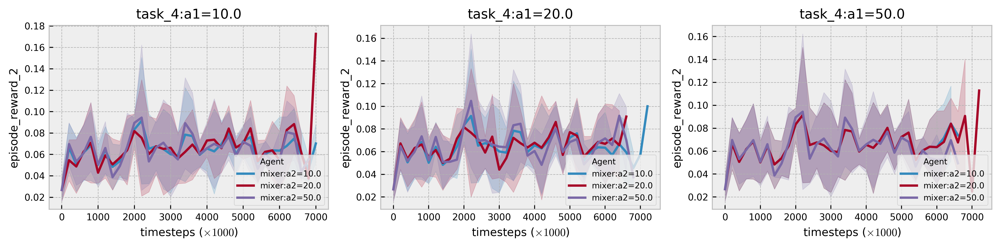

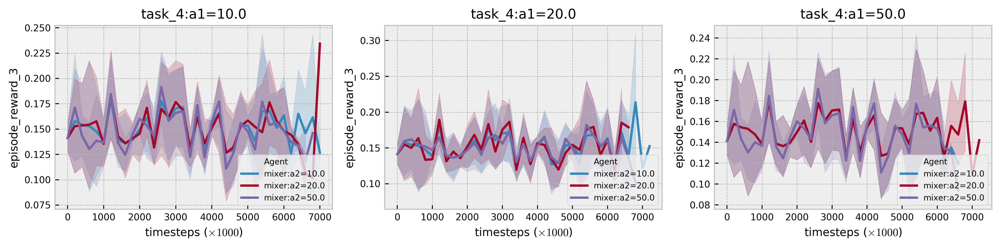

In [228]:
exp_dirs = [
    '../exp/2020.09.13/125020_ddpg_taks4_exclude',
]


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

base_df = load_experiment(exp_dirs, ty='eval')
dfs = []

for d in [4]:
    for aty in ['position']:
        for a0 in [1.0]:
            for a1 in [10.0, 20.0, 50.0]:
                for a2 in [10.0, 20.0, 50.0]:

                    df = base_df.copy()
                    df = filter_df(df, 'difficulty', d)
                    df = filter_df(df, 'action_type', aty)
                    df = filter_df(df, 'alpha_0', a0)
                    df = filter_df(df, 'alpha_1', a1)
                    df = filter_df(df, 'alpha_2', a2)

                    df['Agent'] = f'mixer:a2={a2}'
                    df['env'] = f'task_{d}:a1={a1}'
                    dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

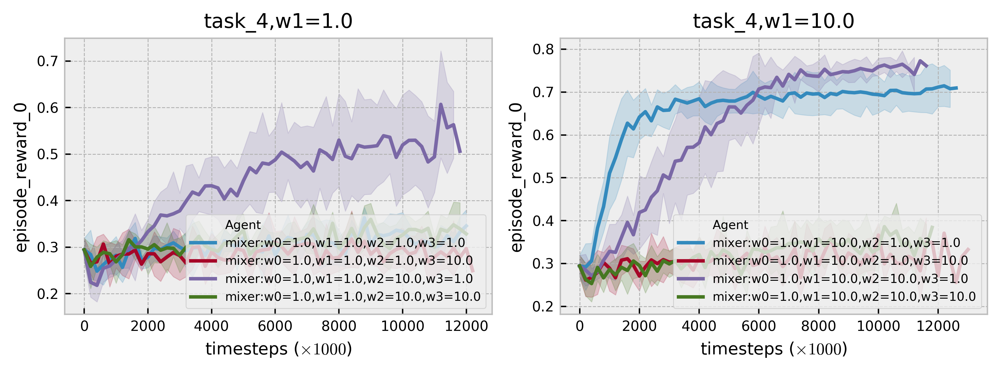

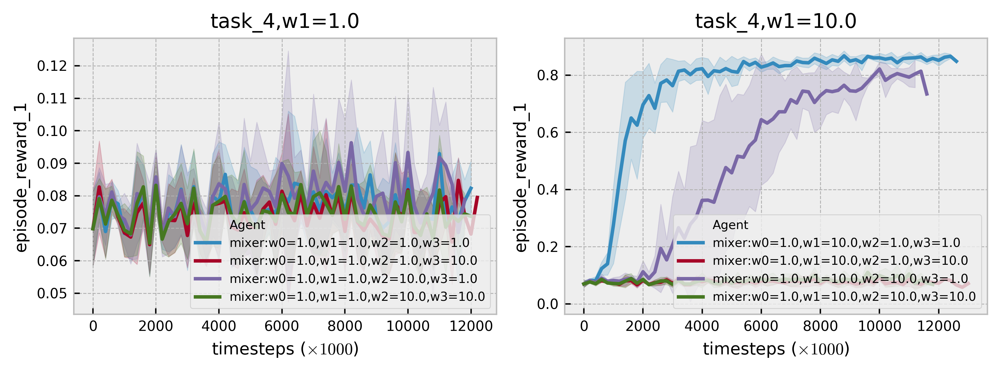

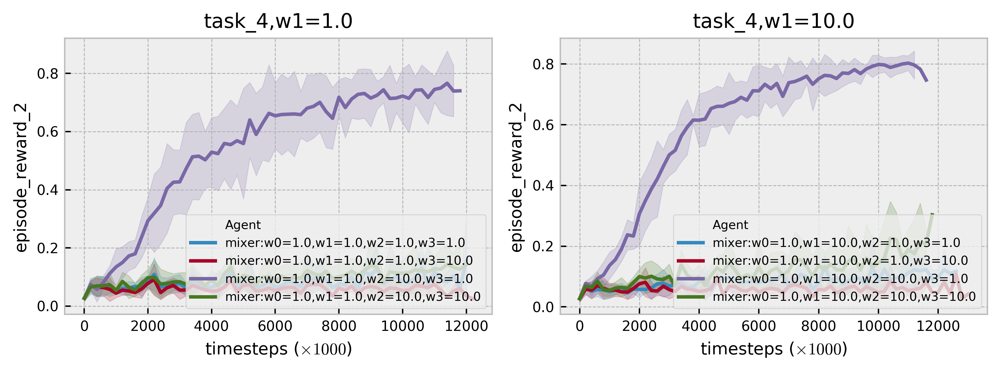

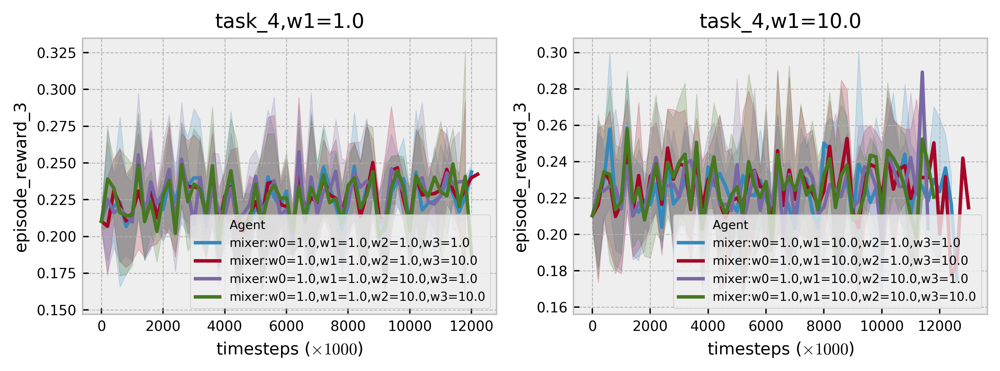

In [104]:
exp_dirs = [
    '../exp/2020.09.15/075109_ddpg_constant_mixer_task4',
]


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

base_df = load_experiment(exp_dirs, ty='eval')
dfs = []

for d in [4]:
    for aty in ['position']:
        for w0 in [1.0]:
            for w1 in [1.0, 10.0]:
                for w2 in [1.0, 10.0]:
                    for w3 in [1.0, 10.0]:

                        df = base_df.copy()
                        df = filter_df(df, 'difficulty', d)
                        df = filter_df(df, 'action_type', aty)
                        df = filter_df(df, 'w0', w0)
                        df = filter_df(df, 'w1', w1)
                        df = filter_df(df, 'w2', w2)
                        df = filter_df(df, 'w3', w3)

                        df['Agent'] = f'mixer:w0={w0},w1={w1},w2={w2},w3={w3}'
                        df['env'] = f'task_{d},w1={w1}'
                        dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

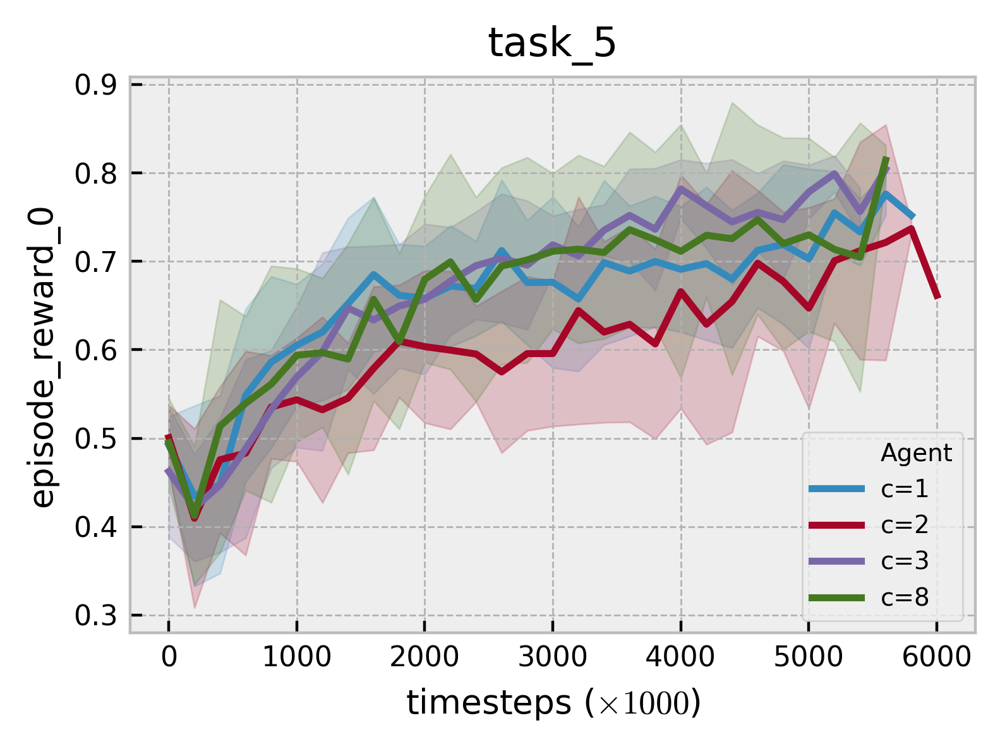

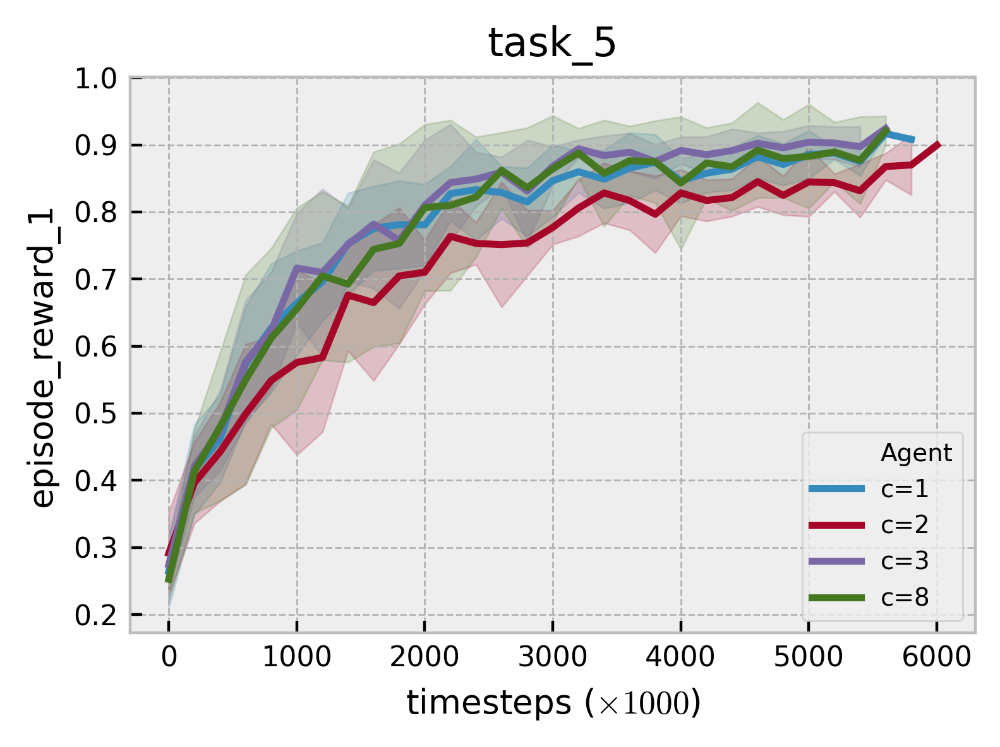

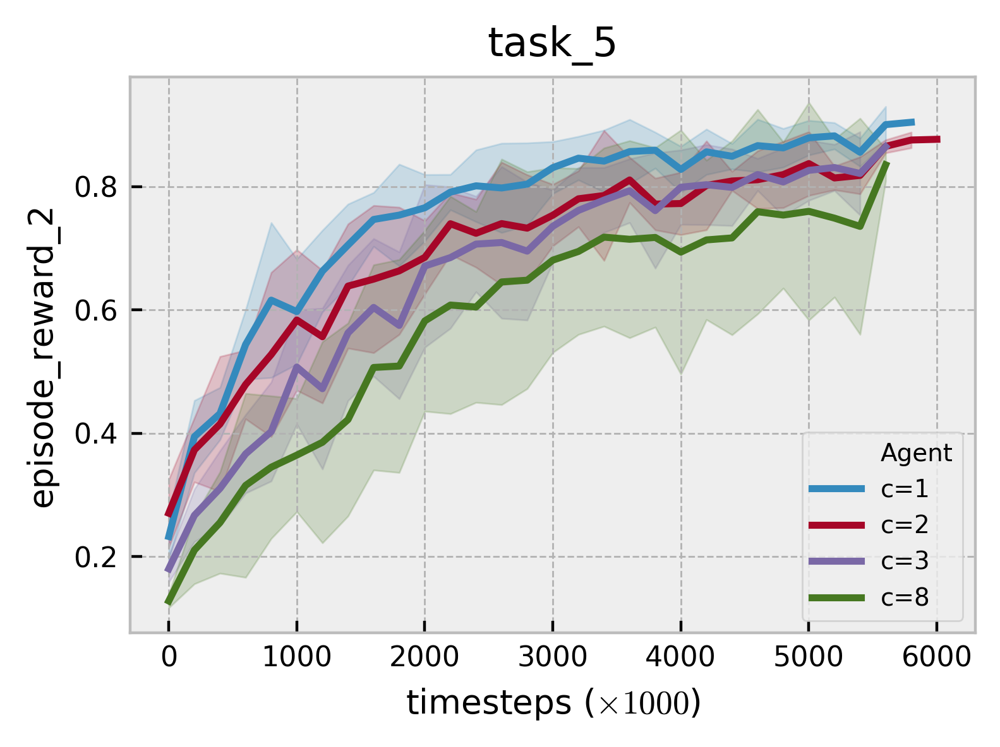

In [160]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.18/135142_ddpg_task5_num_corners',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [5]:
    for n in [1, 2, 3, 8]:
        

        df = base_df.copy()
        df = filter_df(df, 'difficulty', d)
        df = filter_df(df, 'num_corners', n)
        
        df['Agent'] = f'c={n}'
        df['env'] = f'task_{d}'
        dfs.append(df)



            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

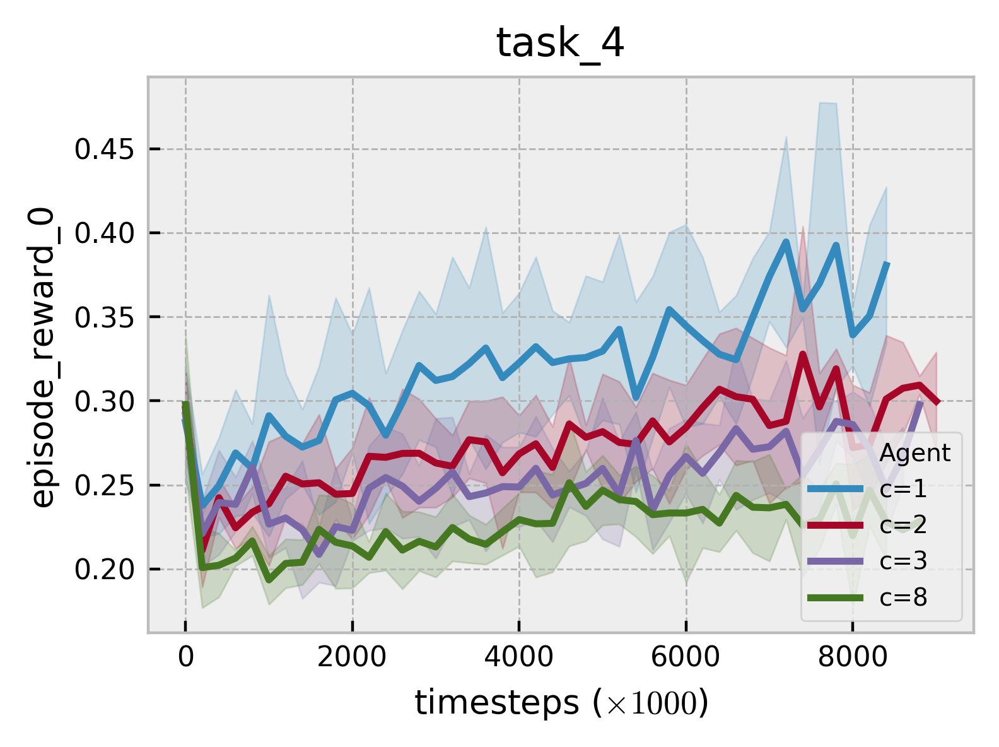

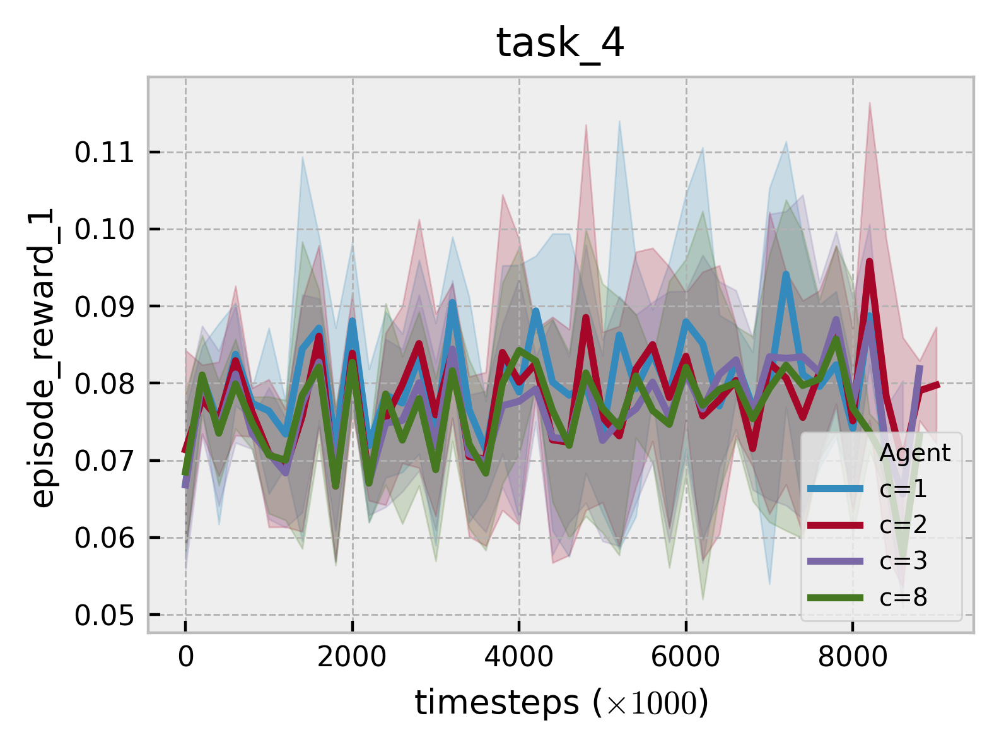

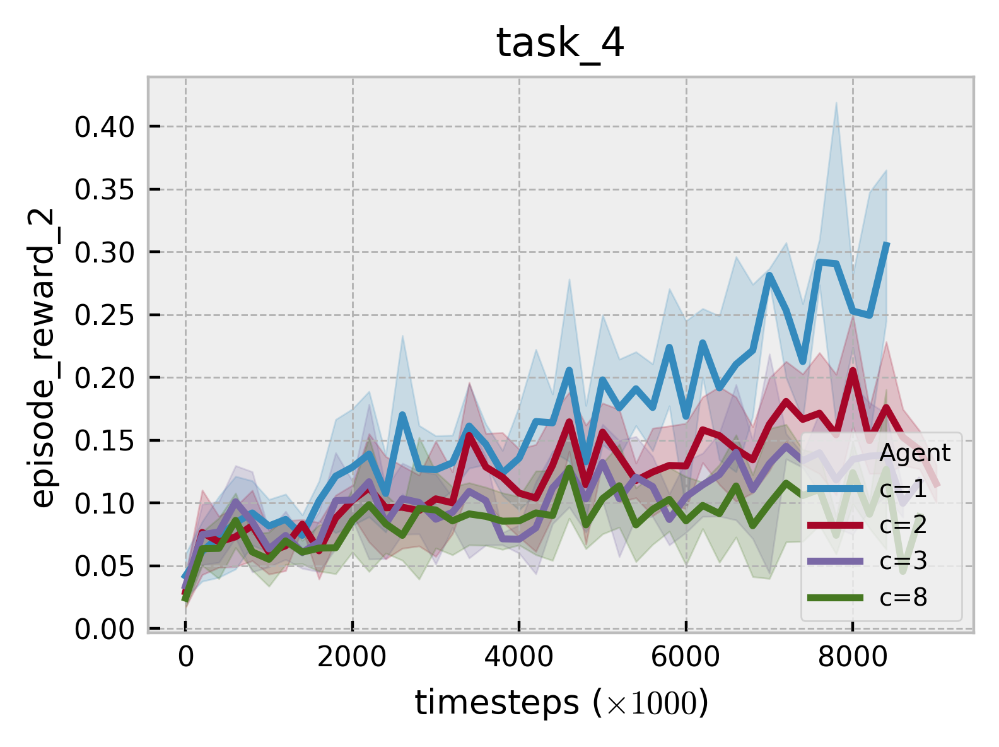

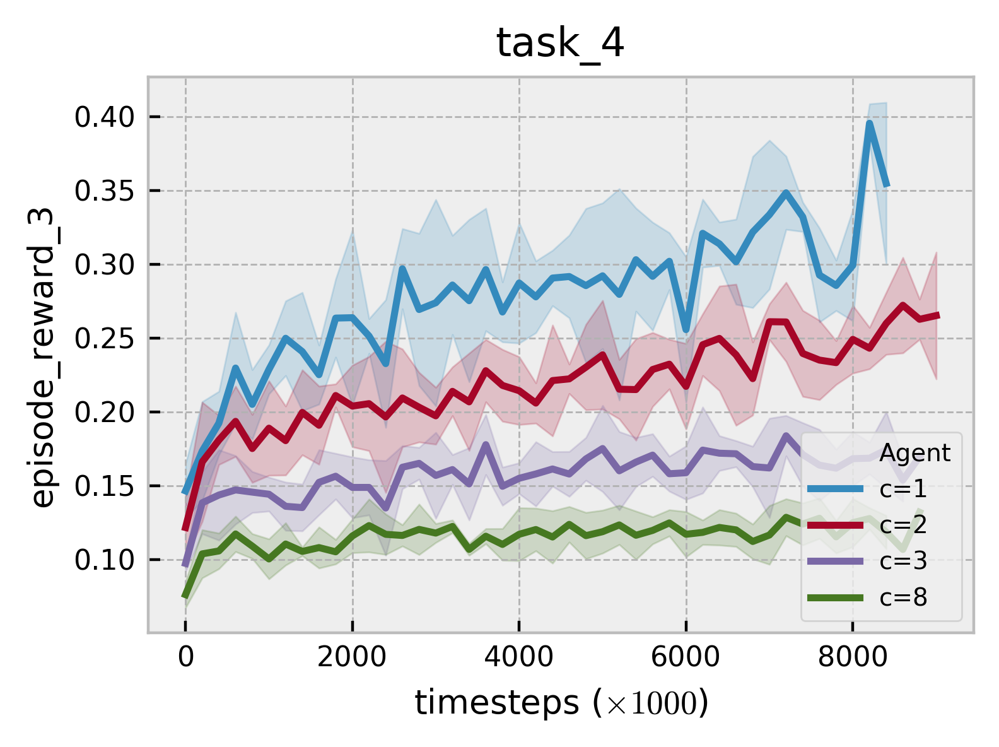

In [161]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.18/135250_ddpg_task4_num_corners',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for n in [1, 2, 3, 8]:
        

        df = base_df.copy()
        df = filter_df(df, 'difficulty', d)
        df = filter_df(df, 'num_corners', n)
        
        df['Agent'] = f'c={n}'
        df['env'] = f'task_{d}'
        dfs.append(df)



            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

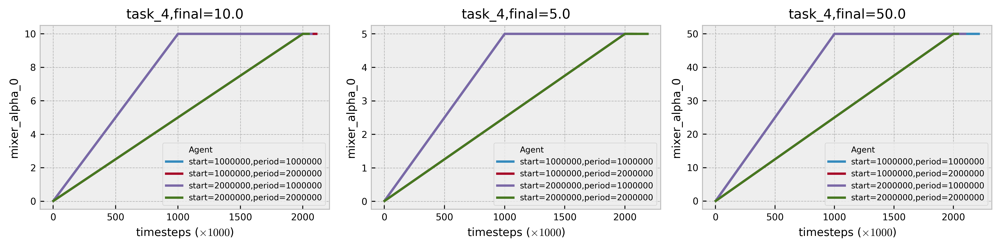

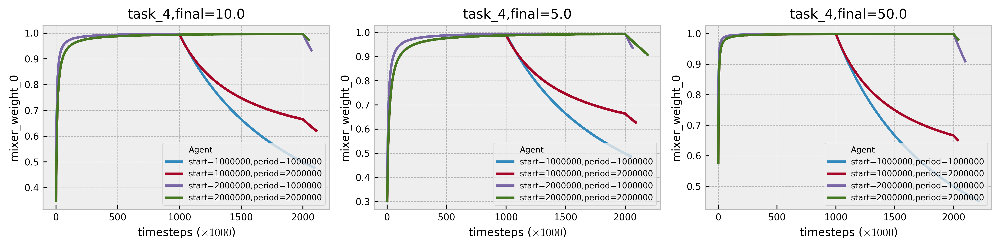

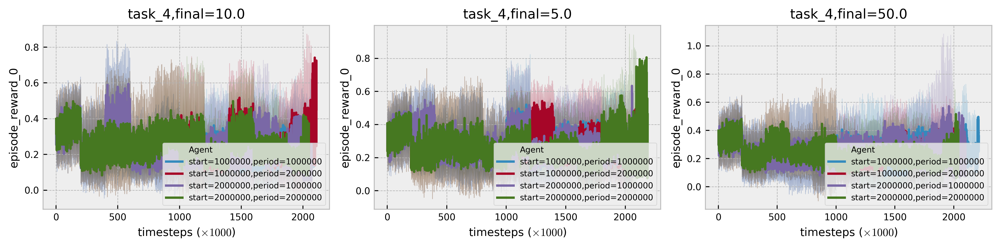

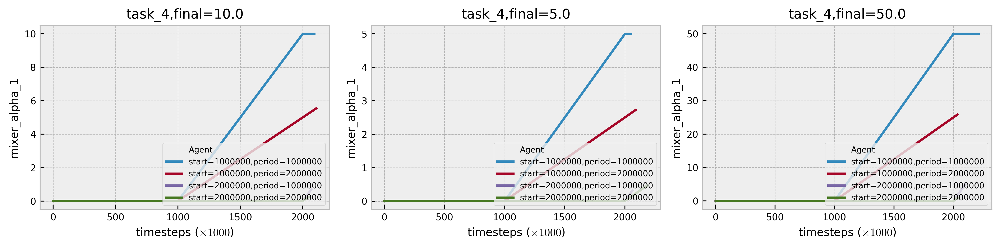

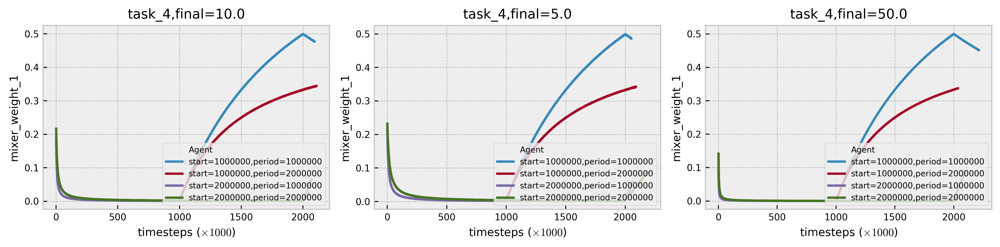

...

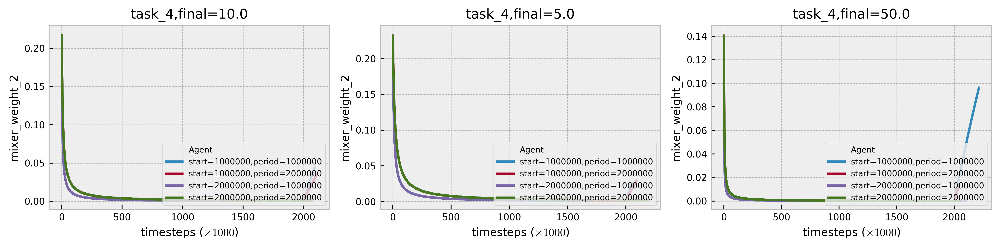

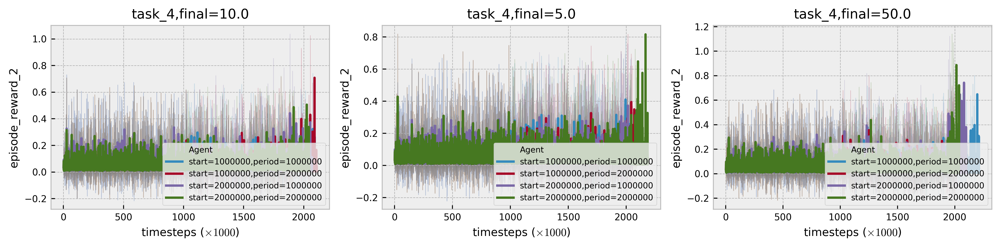

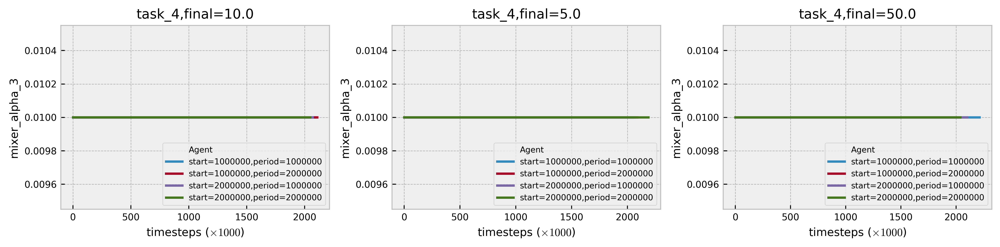

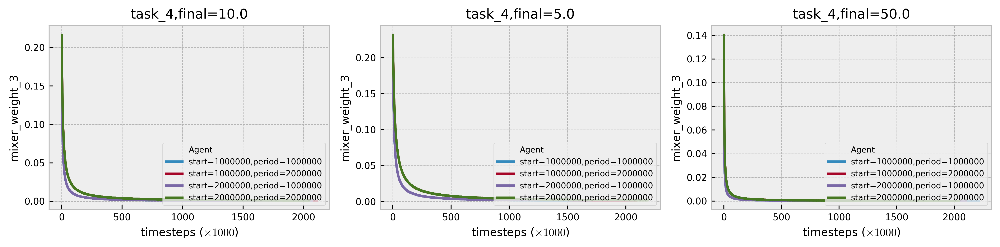

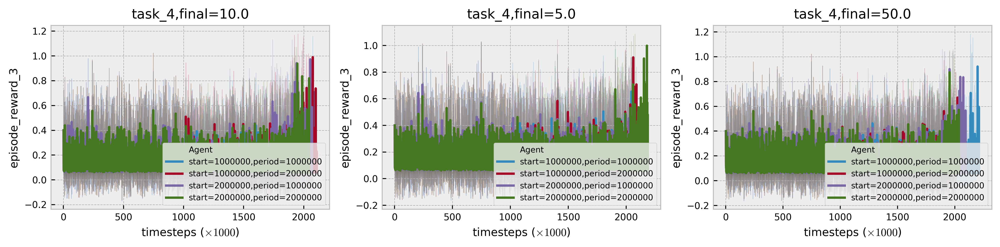

In [60]:
exp_dirs = [
    '../exp/2020.09.16/072958_ddpg_task4_mixer_excluded',
]


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

base_df = load_experiment(exp_dirs, ty='train')
dfs = []

for d in [4]:
    for aty in ['position']:
        for init in [0.01]:
            for final in [5.0, 10.0, 50.0]:
                for start in [1000000, 2000000]:
                    for period in [1000000, 2000000]:

                        df = base_df.copy()
                        df = filter_df(df, 'difficulty', d)
                        df = filter_df(df, 'action_type', aty)
                        df = filter_df(df, 'mixer_init_value', init)
                        df = filter_df(df, 'mixer_final_value', final)
                        df = filter_df(df, 'mixer_start', start)
                        df = filter_df(df, 'mixer_period', period)

                        df['Agent'] = f'start={start},period={period}'
                        df['env'] = f'task_{d},final={final}'
                        dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='mixer_alpha_0')
plot(df, nrow=1, key='mixer_weight_0')
plot(df, nrow=1, key='episode_reward_0')

plot(df, nrow=1, key='mixer_alpha_1')
plot(df, nrow=1, key='mixer_weight_1')
plot(df, nrow=1, key='episode_reward_1')

plot(df, nrow=1, key='mixer_alpha_2')
plot(df, nrow=1, key='mixer_weight_2')
plot(df, nrow=1, key='episode_reward_2')

plot(df, nrow=1, key='mixer_alpha_3')
plot(df, nrow=1, key='mixer_weight_3')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

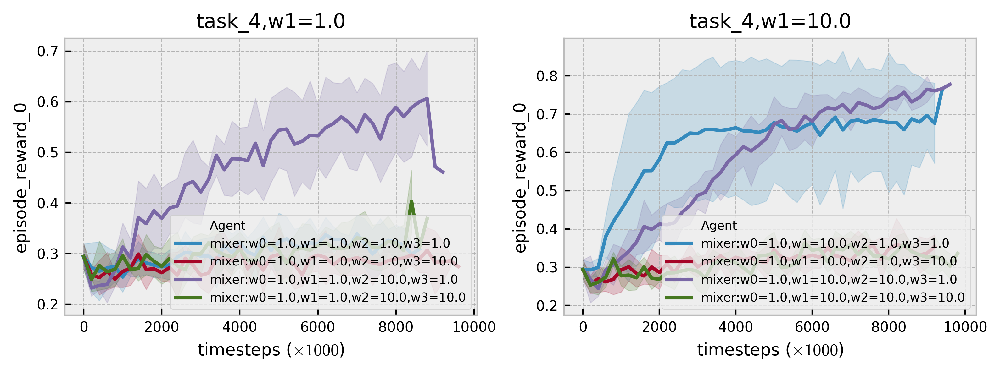

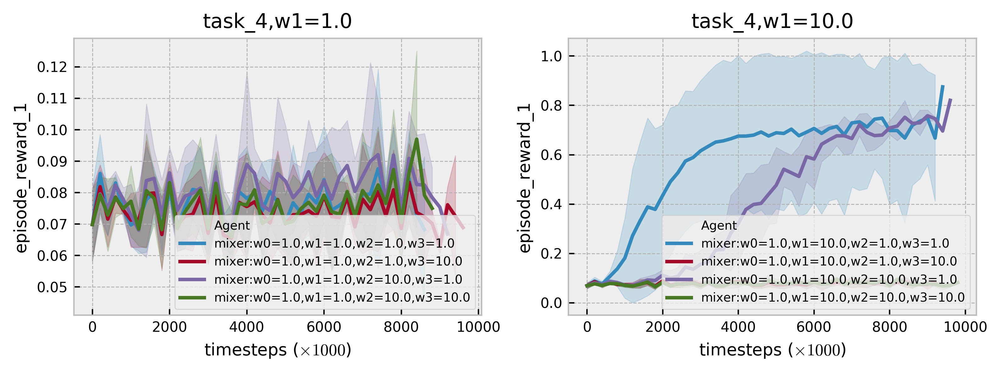

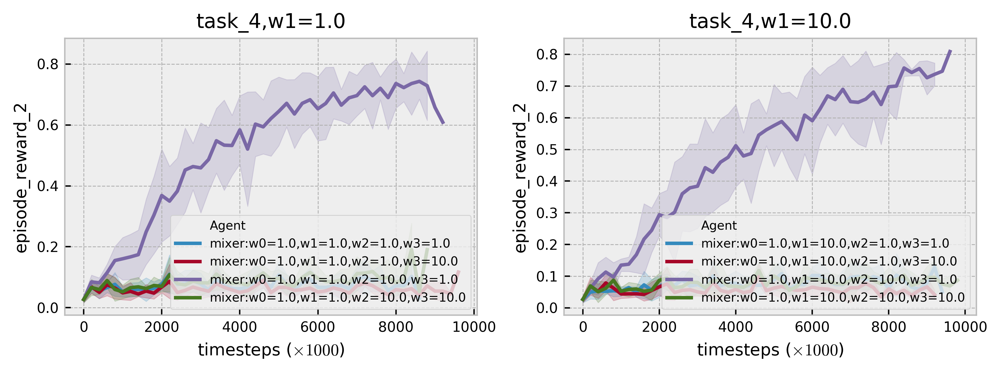

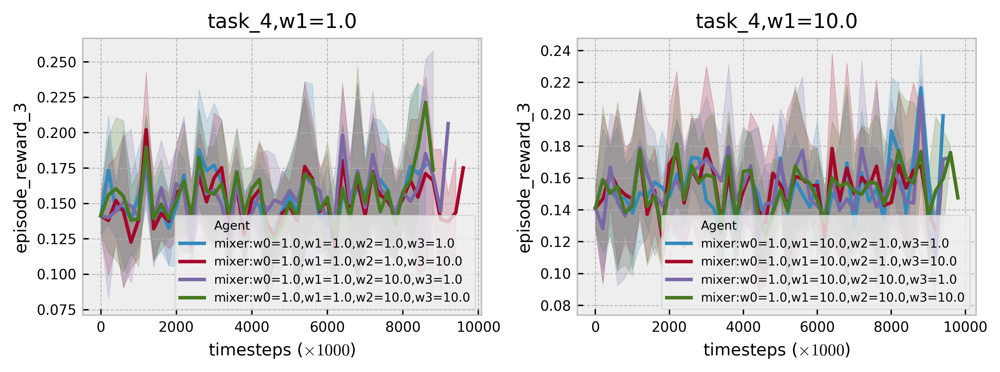

In [106]:
exp_dirs = [
    '../exp/2020.09.16/181935_ddpg_task4_constant_excluded_1_10',
]


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

base_df = load_experiment(exp_dirs, ty='eval')
dfs = []

for d in [4]:
    for aty in ['position']:
        for w0 in [1.0]:
            for w1 in [1.0, 10.0]:
                for w2 in [1.0, 10.0]:
                    for w3 in [1.0, 10.0]:

                        df = base_df.copy()
                        df = filter_df(df, 'difficulty', d)
                        df = filter_df(df, 'action_type', aty)
                        df = filter_df(df, 'w0', w0)
                        df = filter_df(df, 'w1', w1)
                        df = filter_df(df, 'w2', w2)
                        df = filter_df(df, 'w3', w3)

                        df['Agent'] = f'mixer:w0={w0},w1={w1},w2={w2},w3={w3}'
                        df['env'] = f'task_{d},w1={w1}'
                        dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

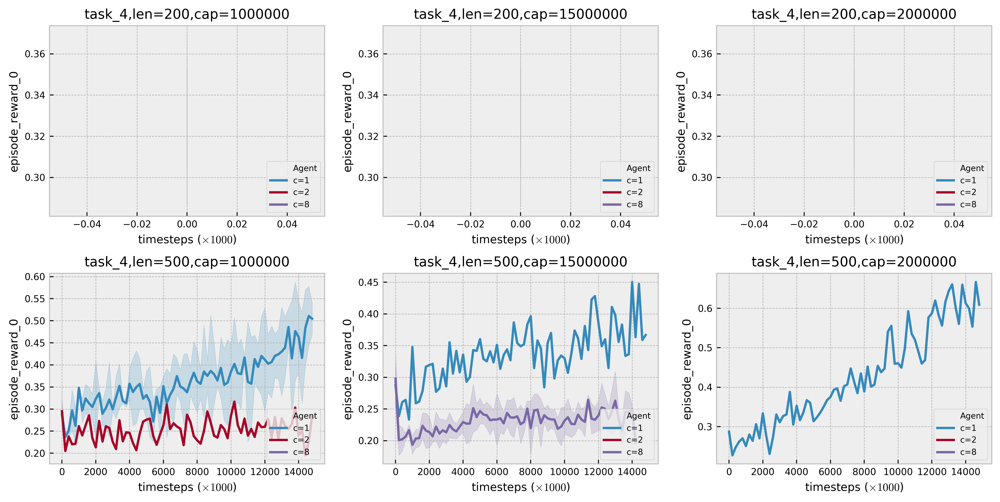

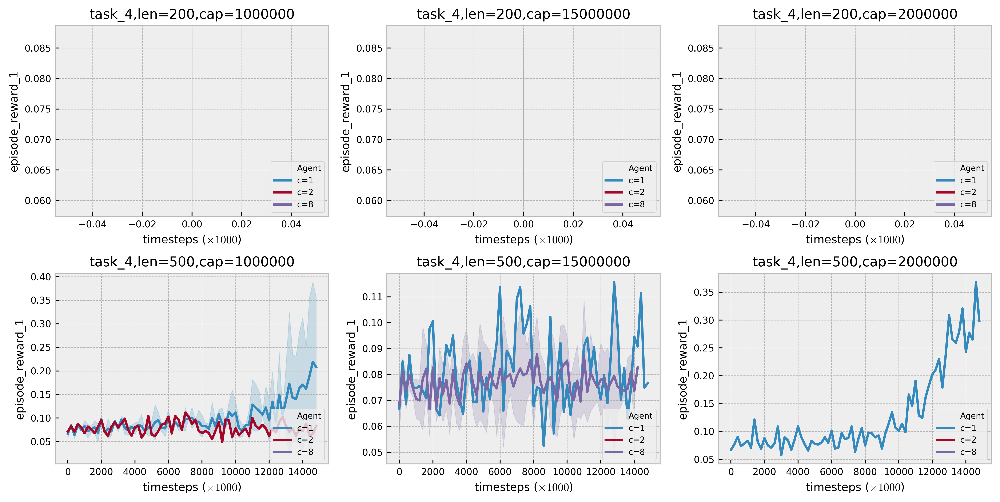

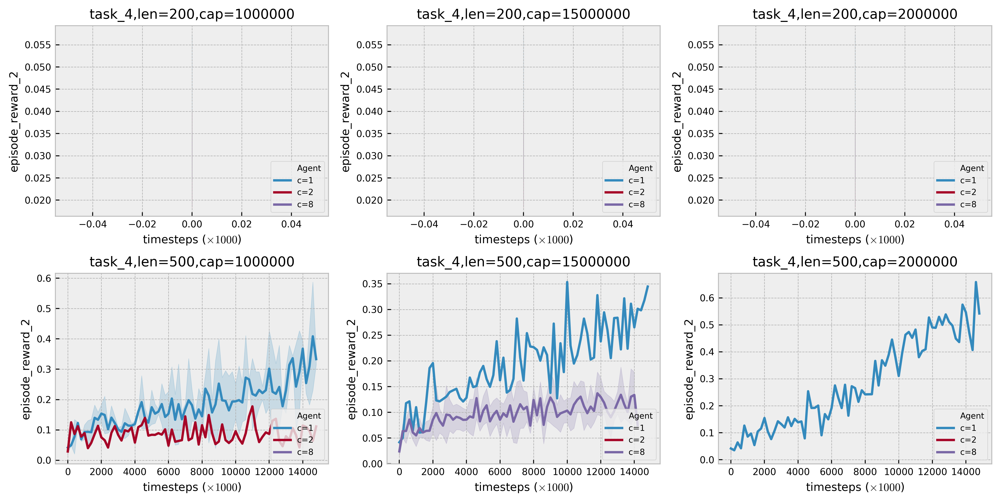

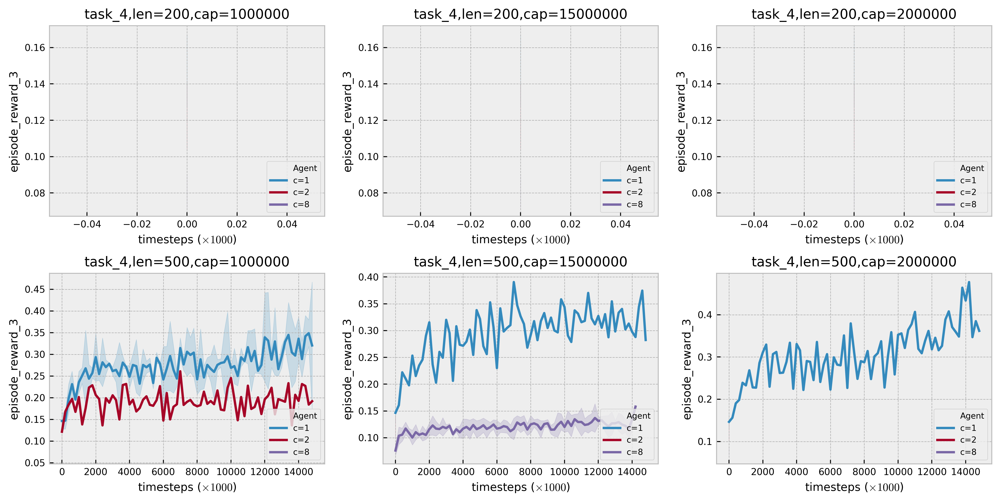

In [243]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.19/070058_ddpg_task4_corners_buffer_eplen',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1, 2, 8]:
        for cap in [1000000, 2000000, 15000000]:
            for l in [200,  500]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'replay_buffer_capacity', cap)
                df = filter_df(df, 'episode_length', l)

                df['Agent'] = f'c={c}'
                df['env'] = f'task_{d},len={l},cap={cap}'
                dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=2, key='episode_reward_0')
plot(df, nrow=2, key='episode_reward_1')
plot(df, nrow=2, key='episode_reward_2')
plot(df, nrow=2, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

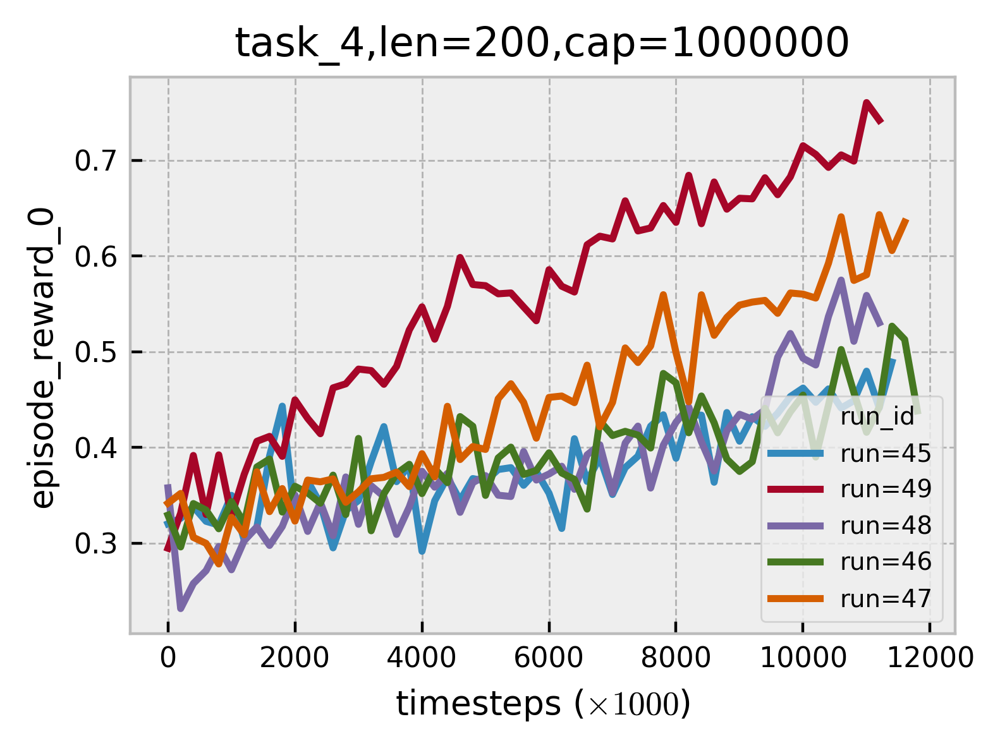

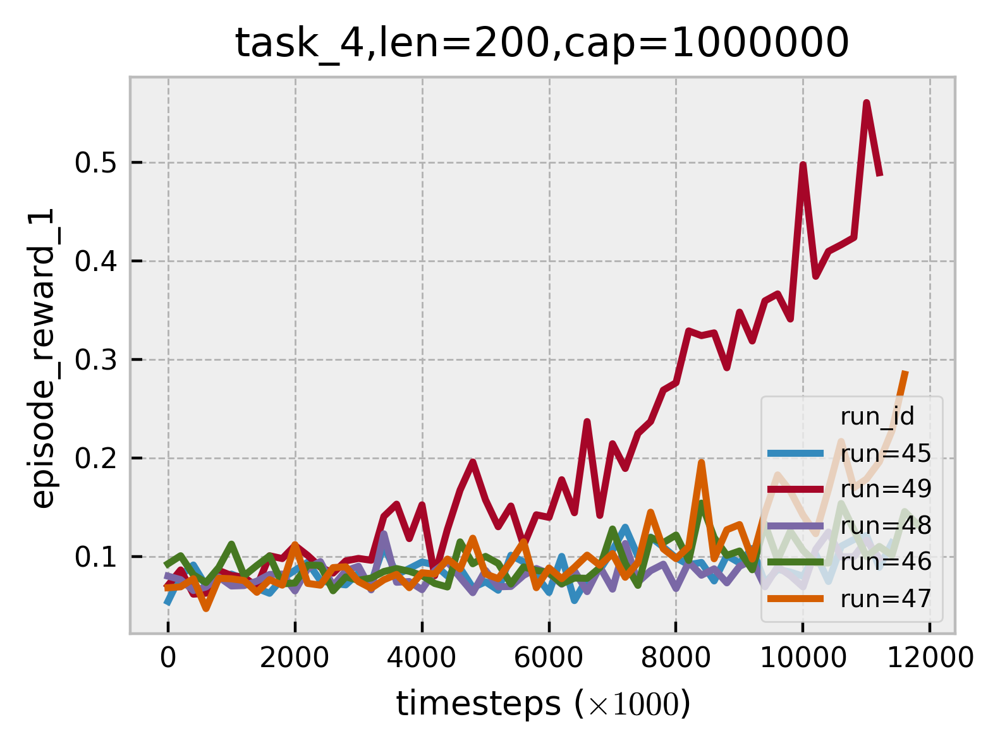

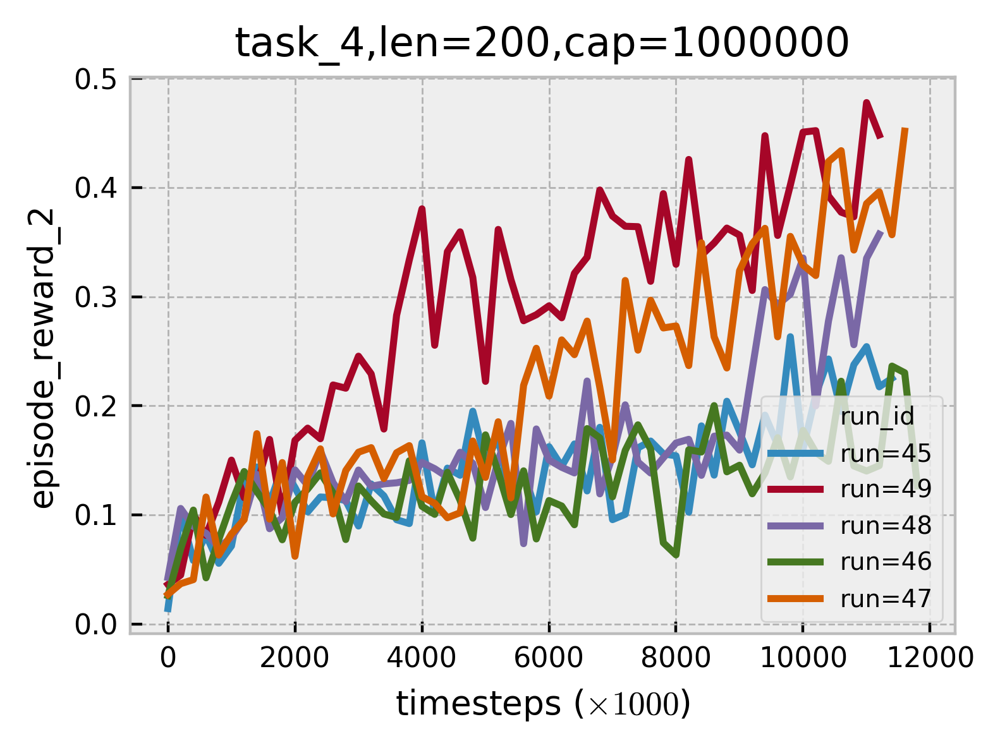

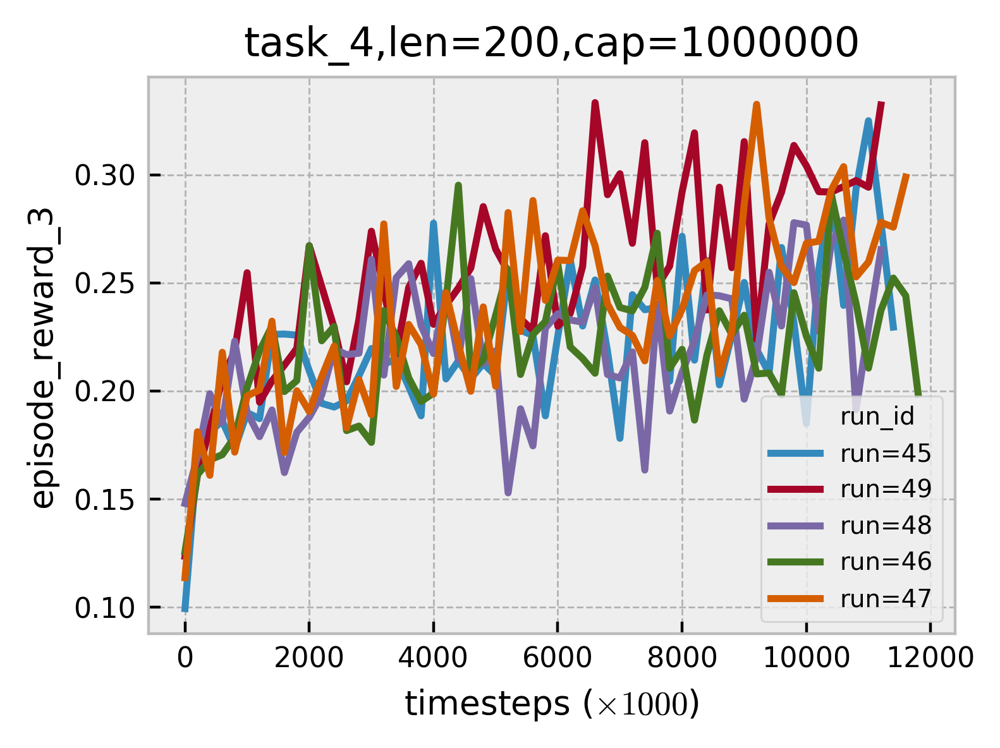

In [238]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.19/070058_ddpg_task4_corners_buffer_eplen',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [2]:
        for cap in [1000000]:
            for l in [200]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'replay_buffer_capacity', cap)
                df = filter_df(df, 'episode_length', l)

                df['Agent'] = f'c={c}'
                df['env'] = f'task_{d},len={l},cap={cap}'
                dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot_runs(df, nrow=1, key='episode_reward_0')
plot_runs(df, nrow=1, key='episode_reward_1')
plot_runs(df, nrow=1, key='episode_reward_2')
plot_runs(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

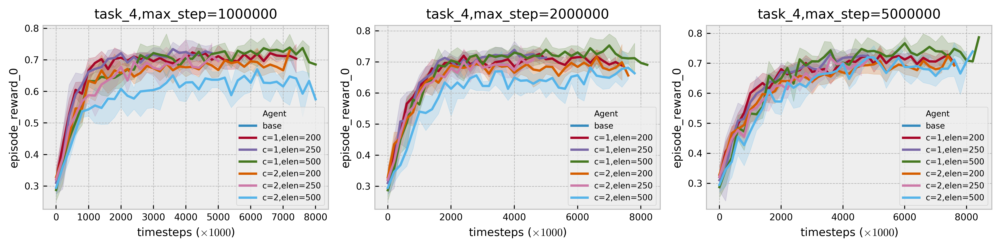

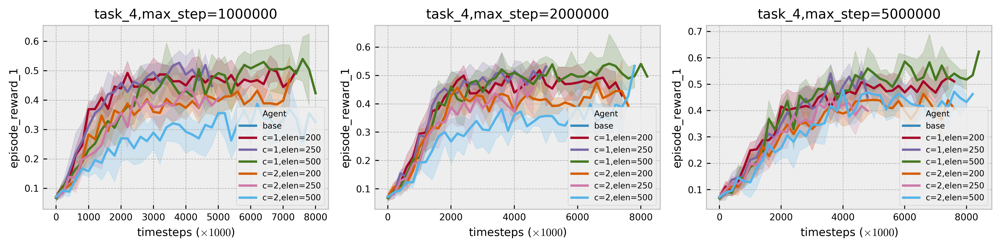

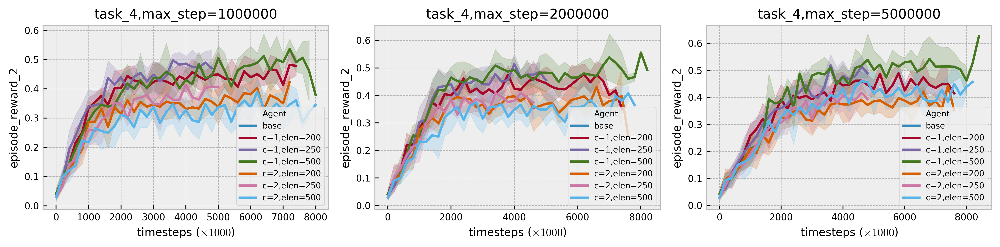

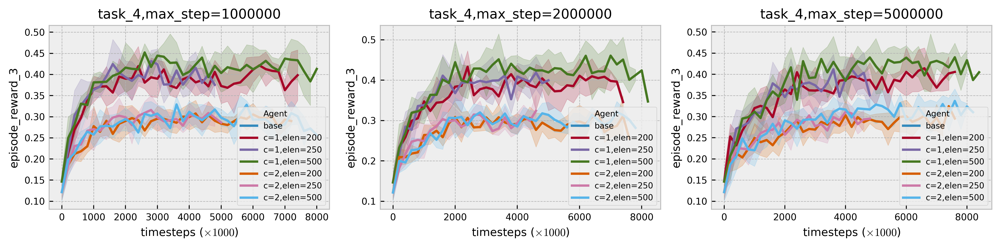

In [268]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.21/065632_ddpg_task4_teacher_corners_elen',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1, 2]:
        for max_step in [1000000, 2000000, 5000000]:
            for l in [200, 500]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'teacher_max_step', max_step)
                df = filter_df(df, 'episode_length', l)

                df['Agent'] = f'c={c},elen={l}'
                df['env'] = f'task_{d},max_step={max_step}'
                dfs.append(df)



exp_dirs = [
    '../exp/2020.09.19/070058_ddpg_task4_corners_buffer_eplen',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1]:
        for cap in [1000000]:
            for l in [200]:
                for max_step in [1000000, 2000000, 5000000]:
        

                    df = base_df.copy()
                    df = filter_df(df, 'difficulty', d)
                    df = filter_df(df, 'num_corners', c)
                    df = filter_df(df, 'replay_buffer_capacity', cap)
                    df = filter_df(df, 'episode_length', l)

                    df['Agent'] = f'base'
                    df['env'] = f'task_{d},max_step={max_step}'
                    dfs.append(df)
                    
                    
                    
exp_dirs = [
    '../exp/2020.09.21/072755_ddpg_task4_teacher_corners_elen250',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1, 2]:
        for max_step in [1000000, 2000000, 5000000]:
            for l in [250]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'teacher_max_step', max_step)
                df = filter_df(df, 'episode_length', l)

                df['Agent'] = f'c={c},elen={l}'
                df['env'] = f'task_{d},max_step={max_step}'
                dfs.append(df)


            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

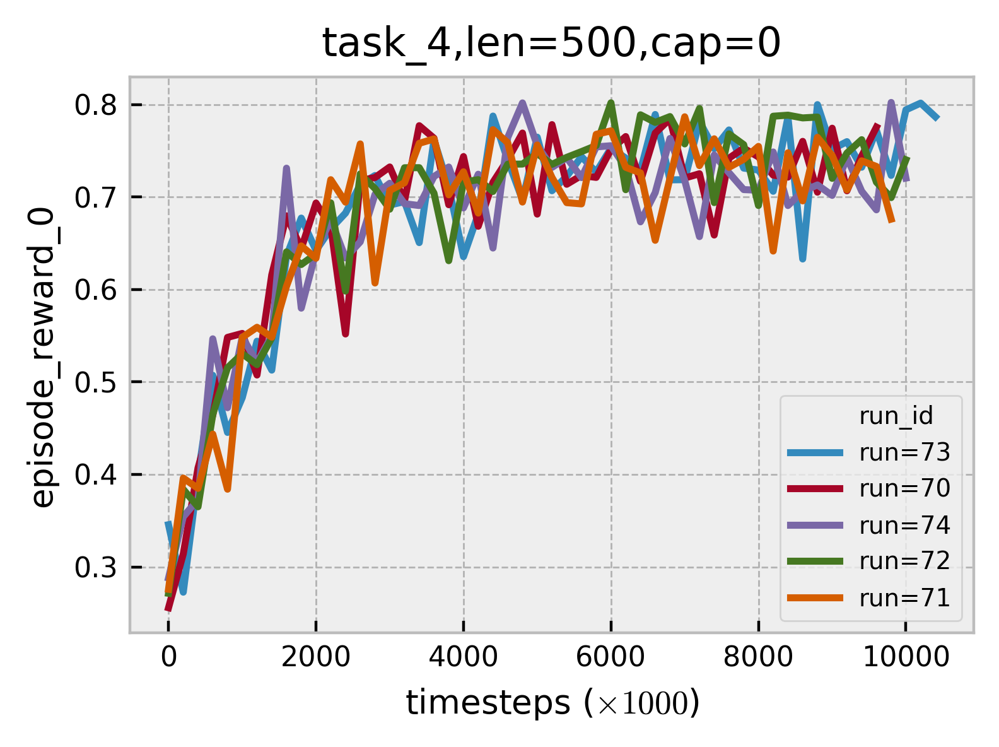

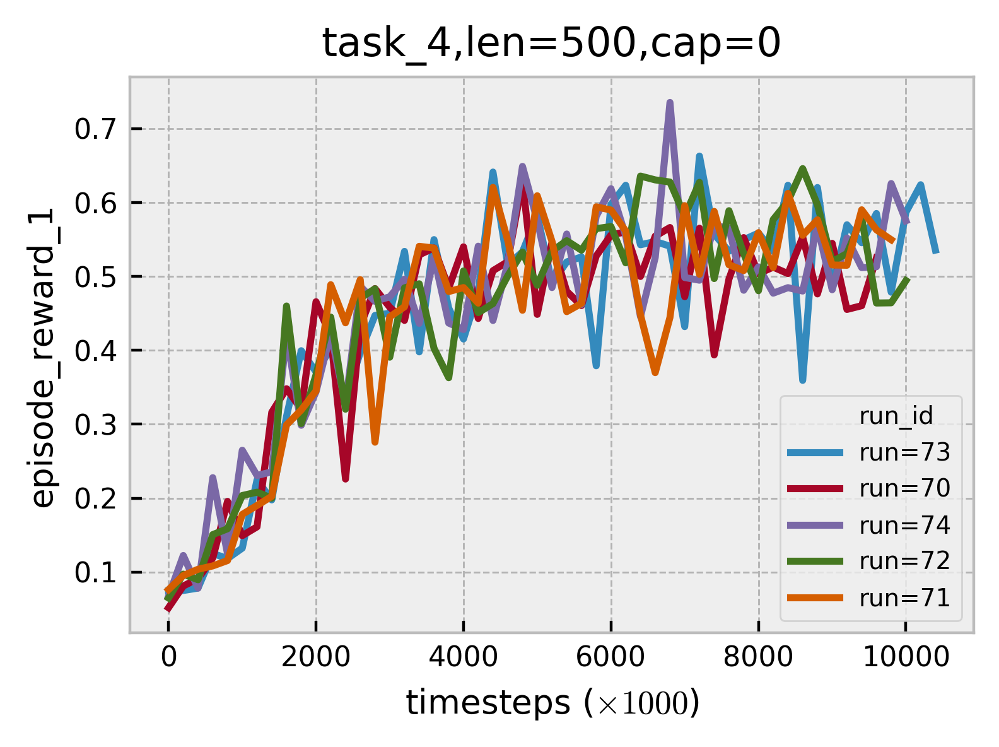

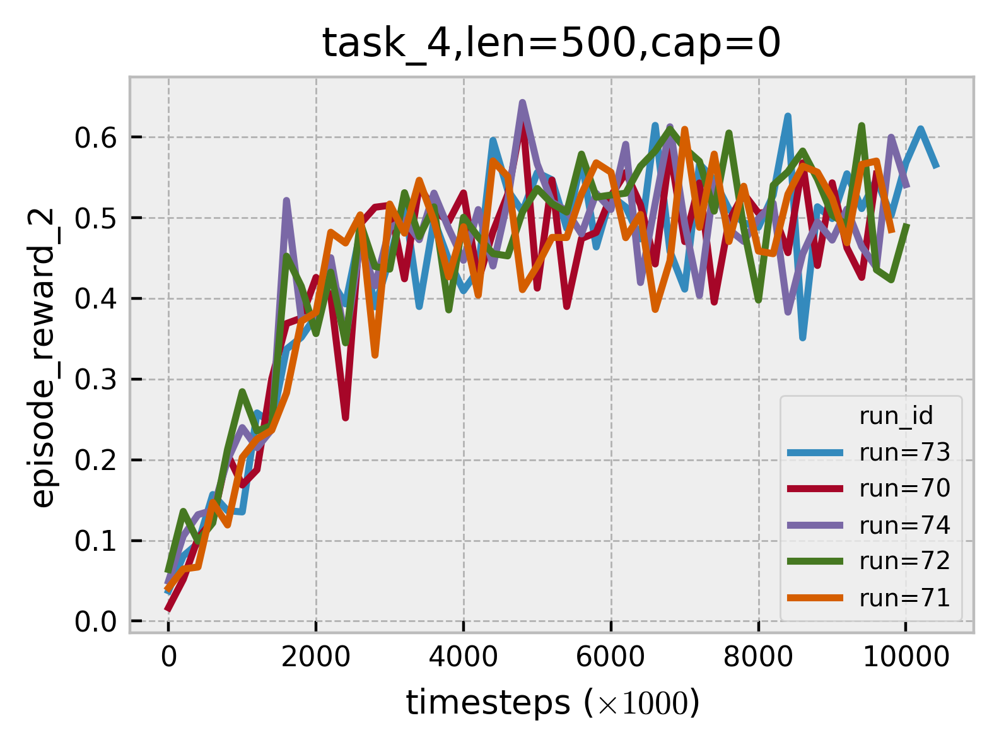

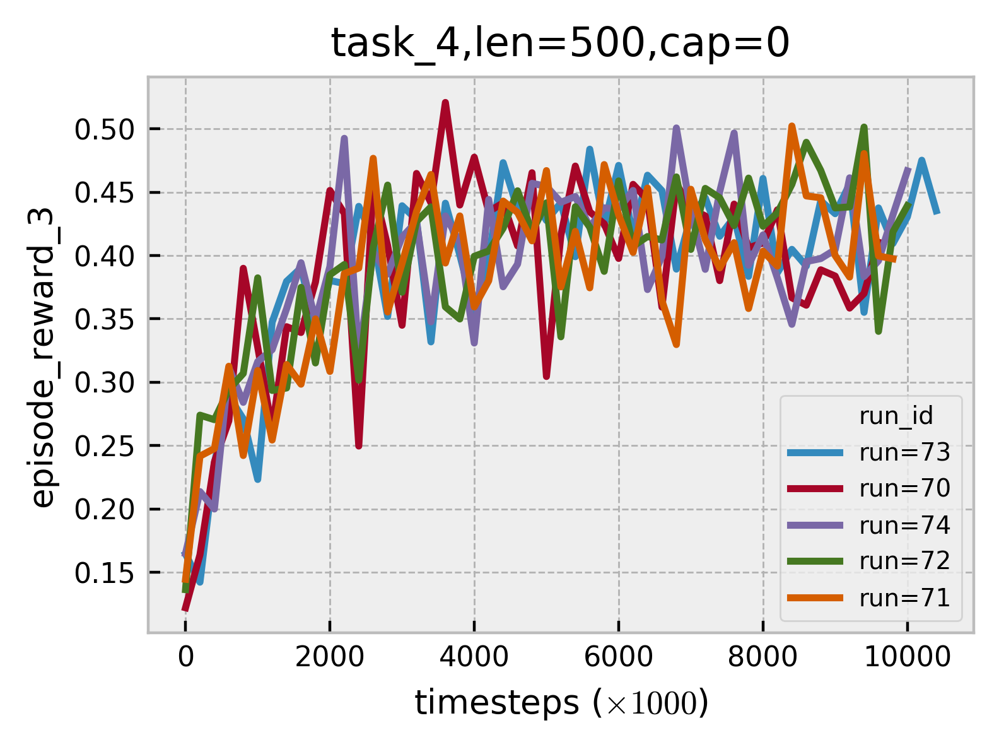

In [273]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.21/065632_ddpg_task4_teacher_corners_elen',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1]:
        for cap in [000000]:
            for max_step in [5000000]:
                for l in [500]:


                    df = base_df.copy()
                    df = filter_df(df, 'difficulty', d)
                    df = filter_df(df, 'num_corners', c)
                    #df = filter_df(df, 'replay_buffer_capacity', cap)
                    df = filter_df(df, 'episode_length', l)
                    df = filter_df(df, 'teacher_max_step', max_step)

                    df['Agent'] = f'c={c}'
                    df['env'] = f'task_{d},len={l},cap={cap}'
                    dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot_runs(df, nrow=1, key='episode_reward_0')
plot_runs(df, nrow=1, key='episode_reward_1')
plot_runs(df, nrow=1, key='episode_reward_2')
plot_runs(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

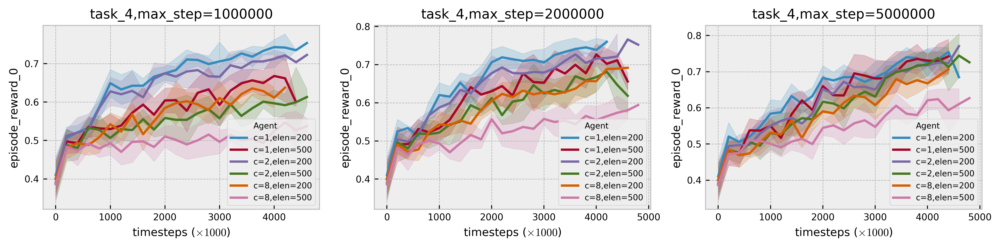

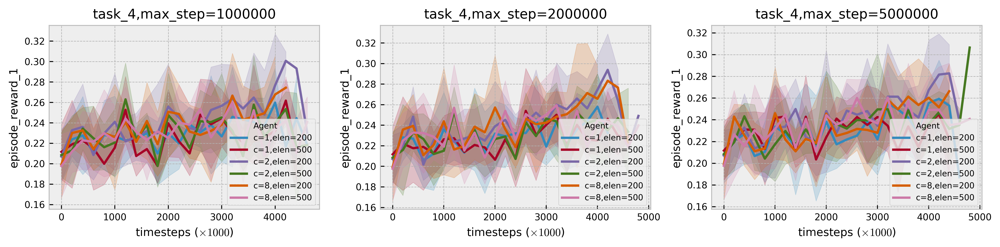

In [269]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.22/075623_ddpg_task4_teach_orignal_rew',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1, 2, 8]:
        for max_step in [1000000, 2000000, 5000000]:
            for l in [200, 500]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'teacher_max_step', max_step)
                df = filter_df(df, 'episode_length', l)

                df['Agent'] = f'c={c},elen={l}'
                df['env'] = f'task_{d},max_step={max_step}'
                dfs.append(df)



            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
#plot(df, nrow=1, key='episode_reward_2')
#plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

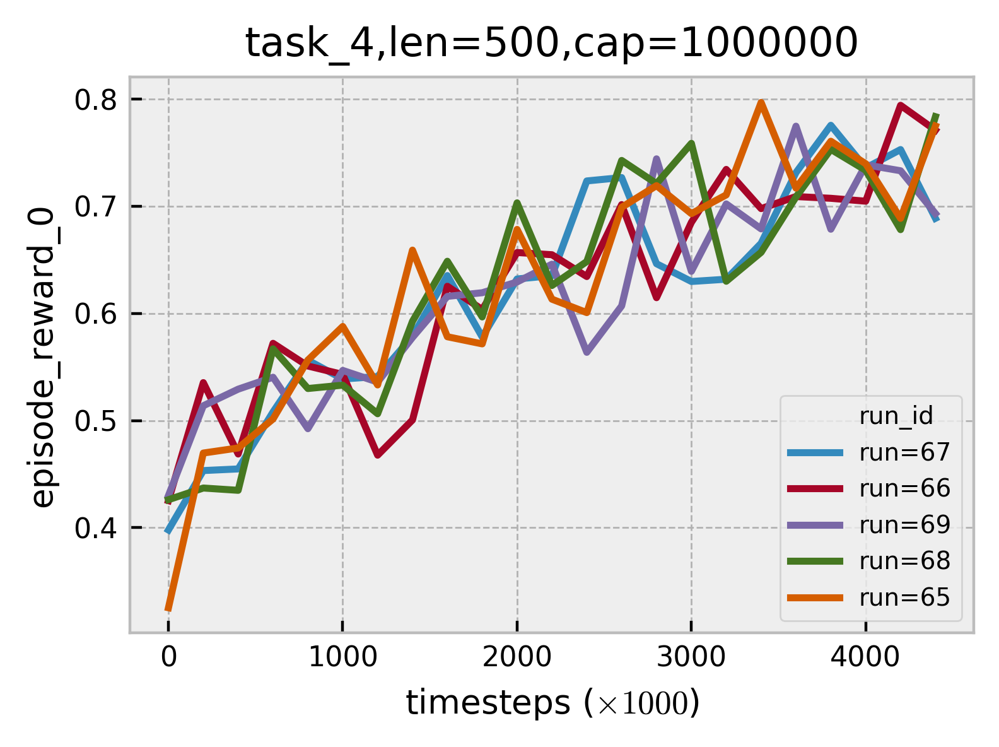

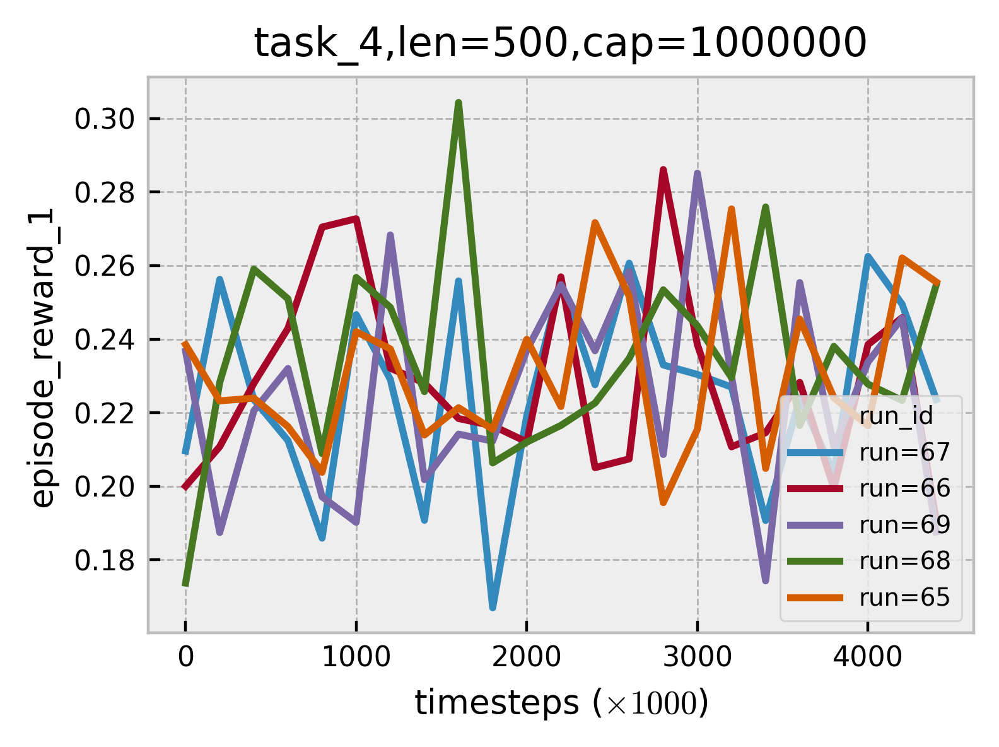

In [272]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.22/075623_ddpg_task4_teach_orignal_rew',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1]:
        for cap in [1000000]:
            for max_step in [5000000]:
                for l in [500]:


                    df = base_df.copy()
                    df = filter_df(df, 'difficulty', d)
                    df = filter_df(df, 'num_corners', c)
                    #df = filter_df(df, 'replay_buffer_capacity', cap)
                    df = filter_df(df, 'episode_length', l)
                    df = filter_df(df, 'teacher_max_step', max_step)

                    df['Agent'] = f'c={c}'
                    df['env'] = f'task_{d},len={l},cap={cap}'
                    dfs.append(df)




            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot_runs(df, nrow=1, key='episode_reward_0')
plot_runs(df, nrow=1, key='episode_reward_1')
#plot_runs(df, nrow=1, key='episode_reward_2')
#plot_runs(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

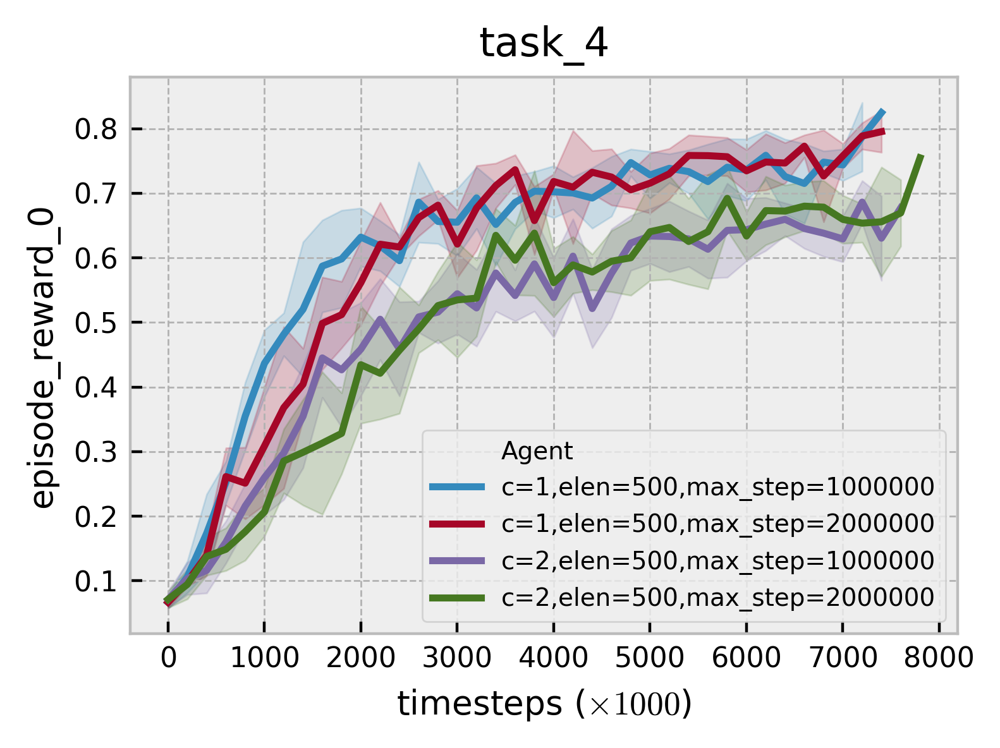

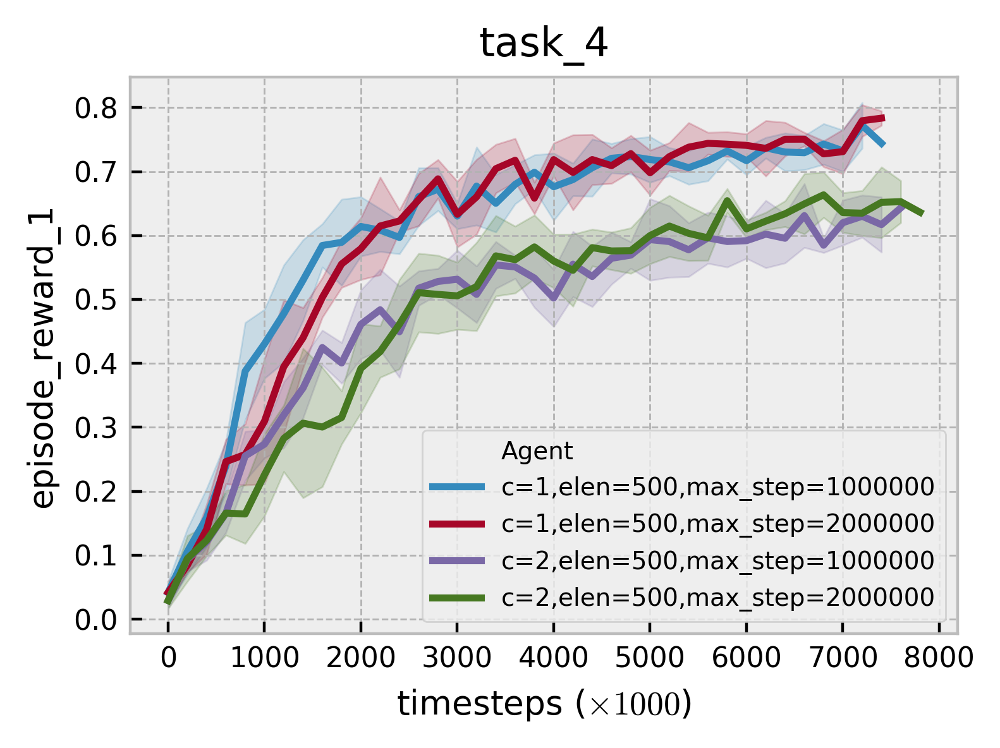

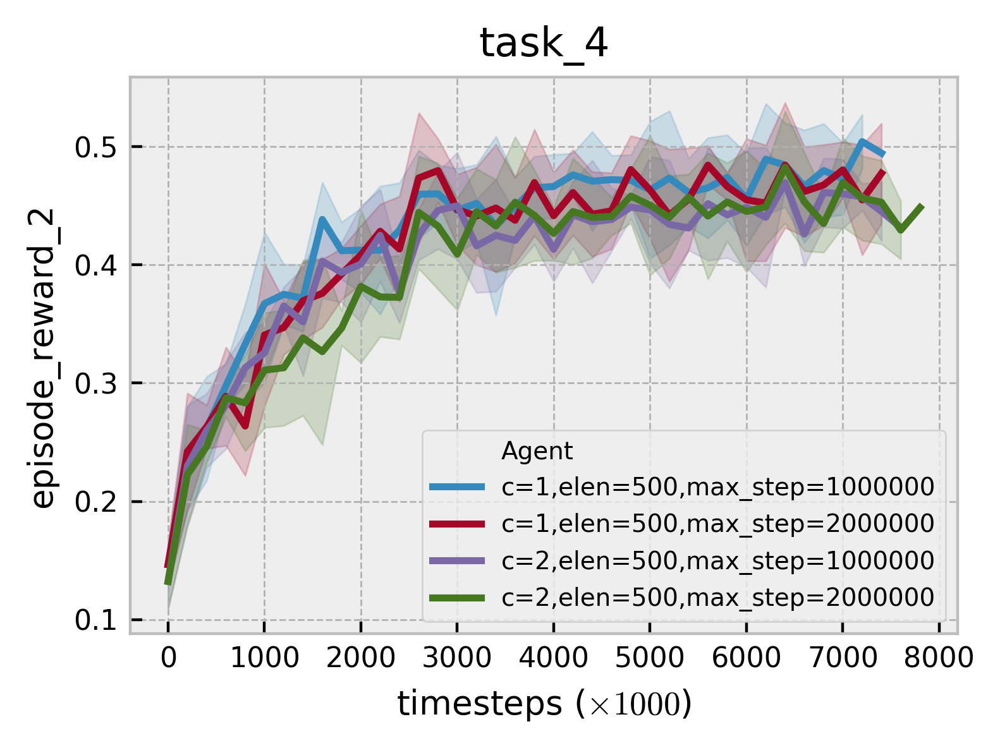

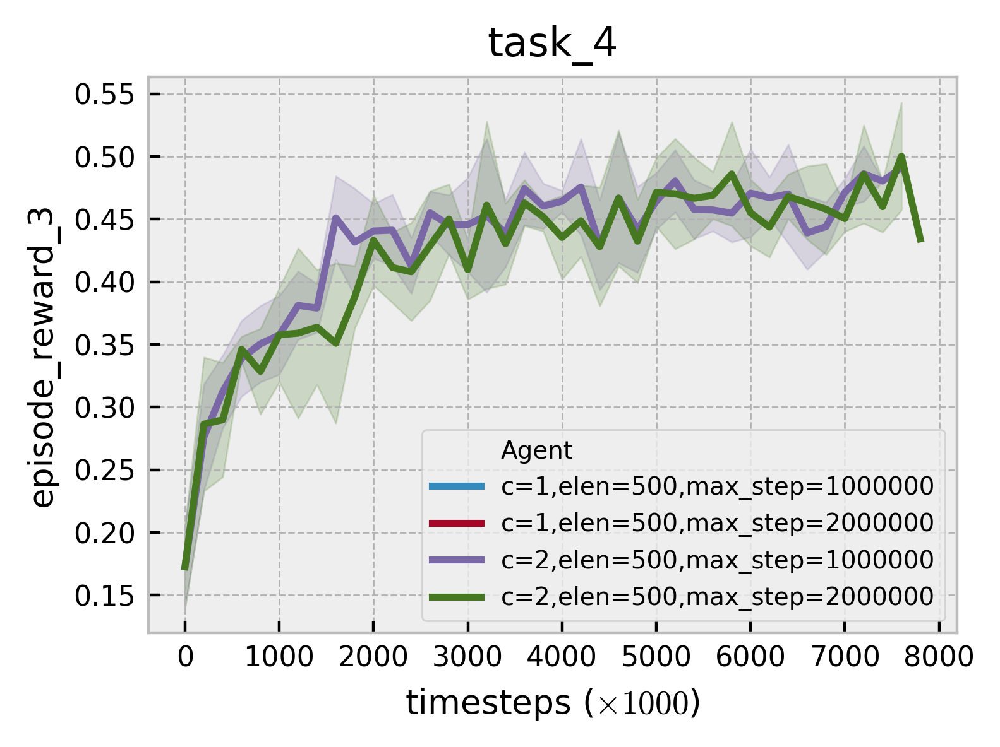

In [304]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.23/073311_ddpg_task4_new_teacher_new_corners',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1, 2]:
        for max_step in [1000000, 2000000]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'teacher_max_step', max_step)

                df['Agent'] = f'c={c},elen={l},max_step={max_step}'
                df['env'] = f'task_{d}'
                dfs.append(df)



            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot(df, nrow=1, key='episode_reward_0')
plot(df, nrow=1, key='episode_reward_1')
plot(df, nrow=1, key='episode_reward_2')
plot(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')

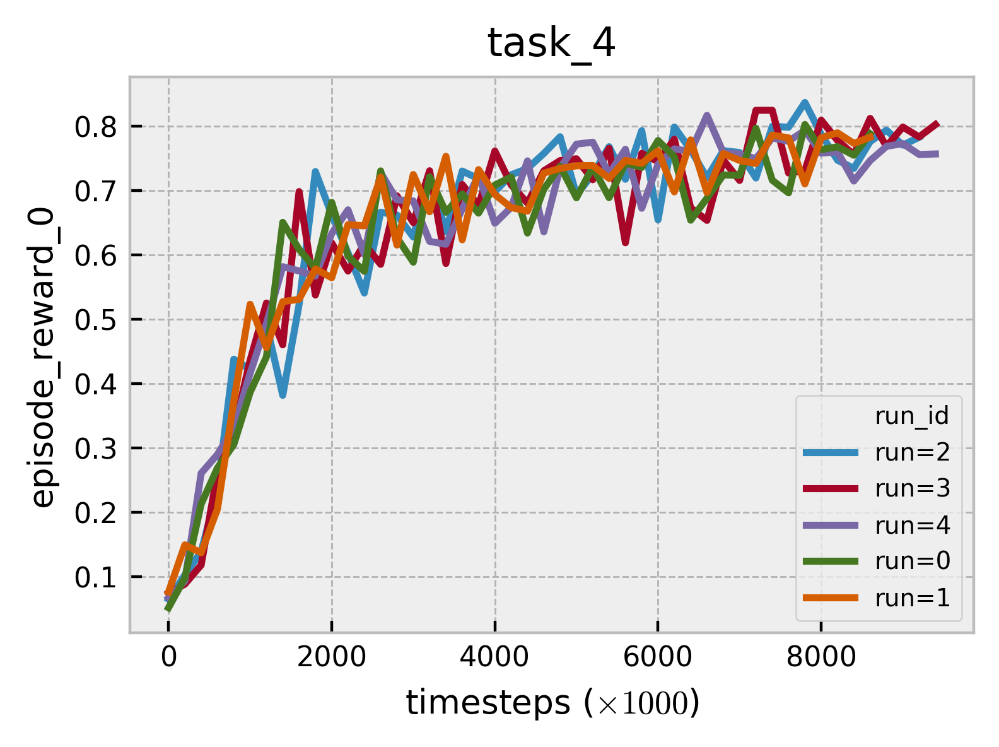

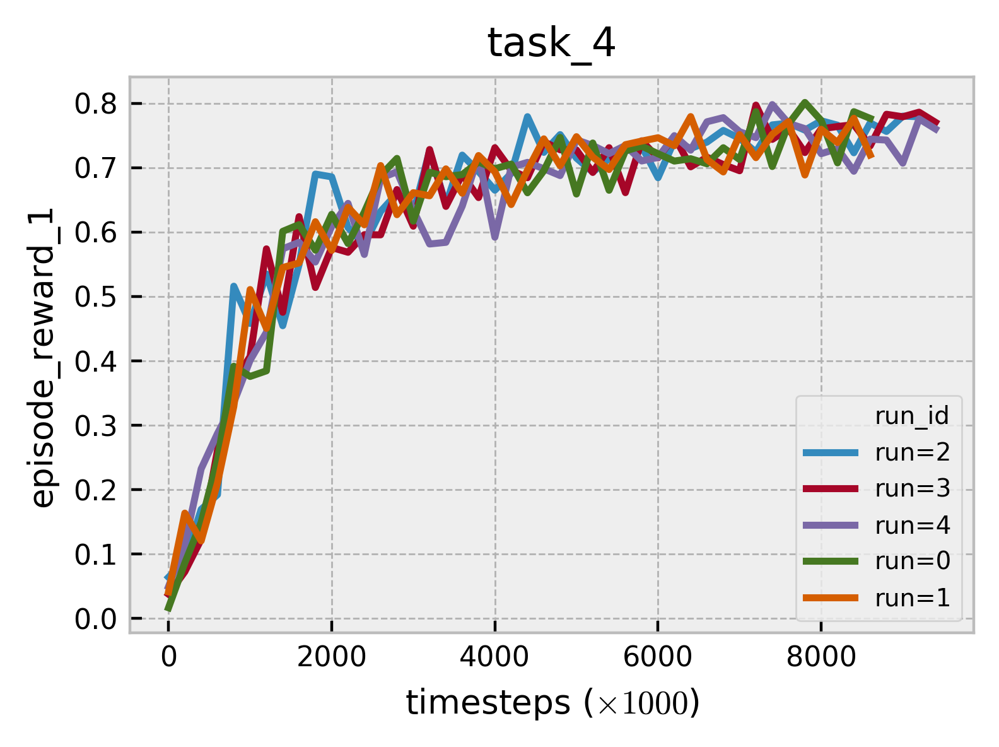

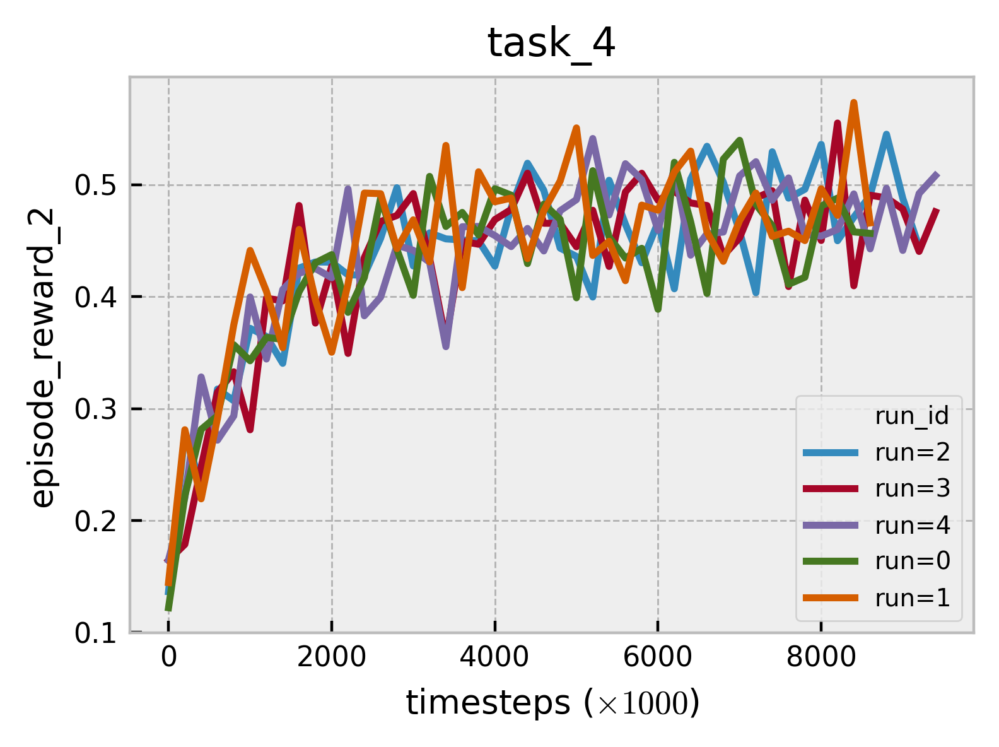

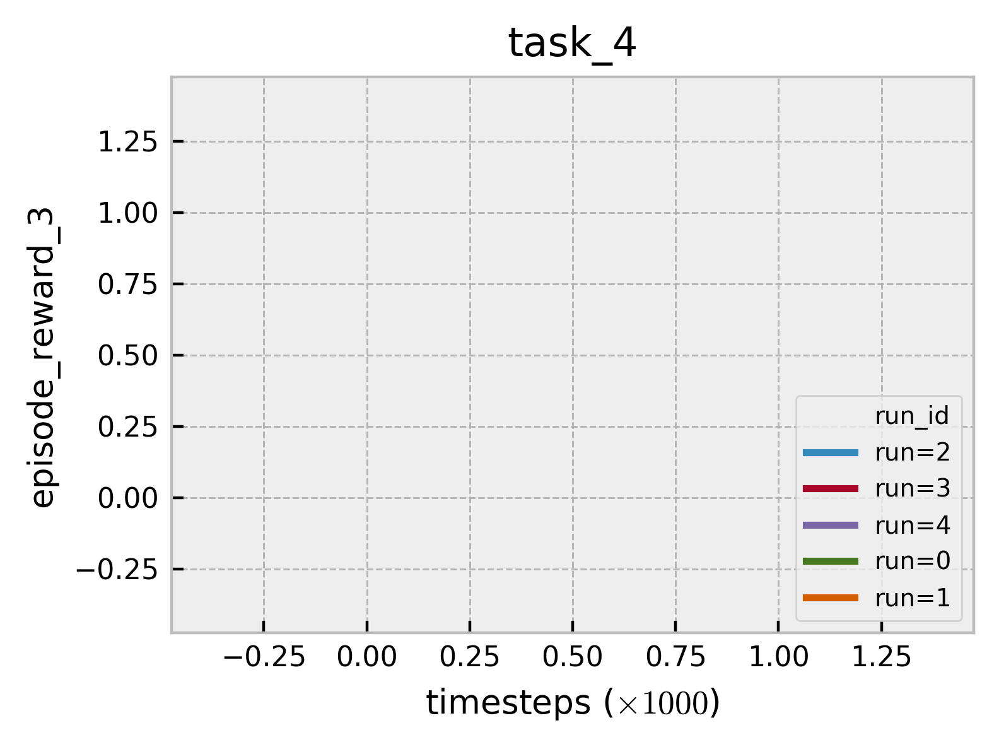

In [309]:
ty = 'eval'


def filter_df(df, key, value):
    if not type(value) == str:
        value = str(value)
    return df[df[key] == value]

dfs = []
exp_dirs = [
    '../exp/2020.09.23/073311_ddpg_task4_new_teacher_new_corners',
]
base_df = load_experiment(exp_dirs, ty=ty)


for d in [4]:
    for c in [1]:
        for max_step in [1000000]:
        

                df = base_df.copy()
                df = filter_df(df, 'difficulty', d)
                df = filter_df(df, 'num_corners', c)
                df = filter_df(df, 'teacher_max_step', max_step)

                df['Agent'] = f'c={c},elen={l},max_step={max_step}'
                df['env'] = f'task_{d}'
                dfs.append(df)

            


df = pd.concat(dfs, sort=False)
#df = df[df['step'] <= 500000]
#plot(df, nrow=4)
plot_runs(df, nrow=1, key='episode_reward_0')
plot_runs(df, nrow=1, key='episode_reward_1')
plot_runs(df, nrow=1, key='episode_reward_2')
plot_runs(df, nrow=1, key='episode_reward_3')
#plot(df, nrow=1, key='mixer_alpha_0')
#plot(df, nrow=1, key='mixer_alpha_1')
#plot(df, nrow=1, key='mixer_alpha_2')
#plot(df, nrow=1, key='mixer_weight_0')
#plot(df, nrow=1, key='mixer_weight_1')
#plot(df, nrow=1, key='mixer_weight_2')